In [69]:
from bertopic import BERTopic
from bertopic.representation import KeyBERTInspired, MaximalMarginalRelevance
from sentence_transformers import SentenceTransformer
from hdbscan import HDBSCAN
from umap import UMAP
from sklearn.feature_extraction.text import CountVectorizer
from bertopic.vectorizers import ClassTfidfTransformer
from IPython.core.interactiveshell import InteractiveShell
import pandas as pd
import numpy as np
import pyarrow
import openpyxl


InteractiveShell.ast_node_interactivity = "all"


In [70]:
# Load the prompt classification data, https://www.kaggle.com/datasets/raghulazhagaiah/chatgpt-prompt-classification
# The dataset revolves around categorizing user prompts within an NLP bot, 
# intending to classify the data into distinct labels
# based on the nature of the queries.
prompt_classification_df = pd.read_csv("data/Creme data copy.csv")

prompt_classification_df.shape
prompt_classification_df.sample(5)




(731, 2)

,Sentence,Label
456,Playful polka dot sundress with a sweetheart n...,FASHION
370,"Wind power generation at higher altitudes, inc...",SCIENCE & TECH
304,when i clear the input by clicking backspace k...,CODING
217,Create templates for key documents relevant to...,SOCIAL
314,Can you give me unique ideas for a user interf...,CODING


In [71]:
## Load the noRobots data https://www.kaggle.com/datasets/bavalpreet26/no-robots-sft
# No Robots is a high-quality dataset of 10,000 instructions and demonstrations created by skilled human annotators. This data can be used for supervised fine-tuning (SFT) to make language models follow instructions better. No Robots was modelled after the instruction dataset described in OpenAI's InstructGPT paper, and is comprised mostly of single-turn instructions across the following categories:

# Data Fields
# The data fields are as follows:

# prompt: Describes the task the model should perform.
# prompt_id: A unique ID for the prompt.
# messages: An array of messages, where each message indicates the role (system, user, assistant) and the content.
# category: Which category the example belongs to (e.g. Chat or Coding).

noRobots_df = pd.read_parquet("data/train_sft-00000-of-00001-8aba5401a3b757f5.parquet")

noRobots_df.shape
noRobots_df.sample(5)


(9500, 4)

,prompt,prompt_id,messages,category
7948,What does this Javascript code snippet do?\n\n...,d188e866020c5e48fdb47176032c565cbad85850ab8695...,[{'content': 'What does this Javascript code s...,Coding
8018,Can you write me fictional instructions on how...,e004f8e8f05341a383ee955ff56647bb0aa1caa5e7d74e...,[{'content': 'Can you write me fictional instr...,Generation
5001,Explain the internet to someone as if it's the...,a16979b07edb296e5c12338204023194b450ed4b295cf2...,[{'content': 'Explain the internet to someone ...,Generation
4478,Write a short story about a scholar who is ren...,d9991b323896dc5f6756afc52fbcf1305e89c6ccb404b7...,[{'content': 'Write a short story about a scho...,Generation
1976,I need a costume idea for a party can you give...,fa98996ee6c8c873bca12920726f40b6a6e32278df3a69...,[{'content': 'I need a costume idea for a part...,Brainstorm


In [94]:
noRobots_df["category"].value_counts()


category
Generation    4346
Open QA       1182
Brainstorm    1060
Chat           796
Rewrite        625
Summarize      395
Classify       334
Coding         334
Closed QA      245
Extract        183
Name: count, dtype: int64

In [72]:
## Load the Simple/Complex single turn data https://www.kaggle.com/datasets/chaitanyahanda/simplecomplex-single-turn-prompts-dataset
# The dataset consists of 600 text-only prompts, each representing a fine-tuned instance of a single-turn user exchange in English.
# The samples are categorized into 10 distinct classes and cover 19 specific use cases. 
# The dataset has been generated using ethically sourced human-in-the-loop data generation methods involving detailed insights of subject matter experts on labeled data for supervised fine-tuning to map input text with corresponding output responses.

simple_turn_df = pd.read_excel("data/Turn 1 (HF).xlsx")
complex_turn_df = pd.read_csv("data/Multi-Turn (HF).csv")

simple_turn_df.shape
complex_turn_df.shape

simple_turn_df.sample(5)
complex_turn_df.sample(5)


(600, 5)

(400, 13)

,S No,Prompts,Use-cases,Type,Categories
198,199,"fun initializeDeliveryTable(rows: Int, columns...",Code helper,Complex,Coding
518,519,Give me the citations for the research papers ...,Citation helper,Complex,Open ended QA
539,540,PANAMA CITY (AP) — José Raúl Mulino said he wa...,Language tutor,Complex,Language Translation
355,356,I want to transform a corner of my living room...,Shopping assistant,Simple,Open ended QA
543,544,Ọ bụ nke a na-akwado ngwa ngwa na ala Nnewi. N...,Language tutor,Simple,Language Translation


,],P1,R1,P2,R2,P3,R3,P4,R4,P5,Use case,Type,Category
40,41,Product Category Sales Quantity Sales Amount D...,To evaluate the sales performance of smartwatc...,compare the total profit generated from electr...,To compare the total profit generated from ele...,find the optimal discount rate that maximizes ...,NaN,NaN,NaN,NaN,Specialized knowledge helper,Complex,Data manipulation
115,116,"In my busy job at the construction site, worki...",To find a good balance between work and person...,and tell me how can I effectively communicate ...,To effectively communicate your boundary-setti...,tell what are 4 practical strategies for maxim...,To maximize the quality of family time during ...,also how can I add variety into my monthly fam...,NaN,NaN,Life coach / counselor,Complex,Open ended QA
345,346,"Explain, how differences in legal frameworks, ...","The differences in legal frameworks, instituti...",Tell the specific political and economic prior...,The key differences in political and economic ...,"Explain, how do international cooperation mech...",NaN,NaN,NaN,NaN,Specialized knowledge helper,Complex,Open ended QA
243,244,write an annotated bibliography in APA style f...,Here is an annotated bibliography for the rese...,did the systematic review identify any variati...,"Based on the search results provided, the syst...",what were the primary findings regarding the c...,NaN,NaN,NaN,NaN,Citation helper,Simple,Writing
276,277,Gravity was the first fundamental force that h...,Physicists face significant challenges in reco...,Are infinities emerging frm mathematics of mer...,The emergence of infinities in the attempts to...,"Why is the discrepancy between the smooth, cla...","The discrepancy between the smooth, classical ...",can we develop new theoretical frameworks or t...,The search results provide insights into the c...,can the existing quantum descriptions of elect...,Academic writing helper,Complex,Writing


In [73]:
# Load prompt analysis data from OpenAI https://www.kaggle.com/datasets/golammostofas/prompt-analysis-data
# The standardchats.csv dataset contains chat logs generated by OpenAI. 
# This dataset is intended for natural language processing (NLP) and machine learning tasks such as chatbot development, sentiment analysis, and text classification. 
# It provides a rich set of conversations useful for building and improving conversational AI systems.

prompt_analysis_df = pd.read_csv("data/standardchats.csv")

prompt_analysis_df.shape
prompt_analysis_df.sample(5)


(1181246, 8)

,_id,user,chatHistory,prompt,answer,createdAt,updatedAt,__v
265875,663a84c81e21e6552fdb88f6,6638d9de1e21e6552f9660f4,663a84ac1e21e6552fdb7f60,216 est-il pair?,"Oui, 216 est un nombre pair.",2024-05-07T19:45:12.643Z,2024-05-07T19:45:12.643Z,0
627529,663c3928293d71d1fc7e8f59,663be7a61e21e6552f22276f,663c3927293d71d1fc7e8f47,326 divisé par deux?,326 divisé par 2 égale 163.,2024-05-09T02:47:04.680Z,2024-05-09T02:47:04.680Z,0
639752,663c4fa0293d71d1fc805782,663be7a61e21e6552f22276f,663c4f6e293d71d1fc8053c8,le cube de 549?,Le cube de 549 est calculé en élevant 549 à la...,2024-05-09T04:22:56.109Z,2024-05-09T04:22:56.109Z,0
597729,663c167f1e21e6552f3173a7,663be37c1e21e6552f21ef4a,663c16481e21e6552f315e46,la somme de 122 et 2?,The sum of 122 and 2 equals 124.,2024-05-09T00:19:11.701Z,2024-05-09T00:19:11.701Z,0
897967,663ce6c370047d9b8cfce85b,663be7a61e21e6552f22276f,663ce69170047d9b8cfcd1f4,le cube de 1060?,Le cube de 1060 est égal à 11248616000.,2024-05-09T15:07:47.813Z,2024-05-09T15:07:47.813Z,0


In [74]:
## Define model components and parameters
from bertopic.representation import PartOfSpeech



sentence_model = SentenceTransformer("all-MiniLM-L6-v2")

# Define UMAP models, different for each data type. pre-defined parameters (n_neighbors=15, n_components=5, min_dist=0.0, metric='cosine', random_state=42)
umap_model = UMAP(n_neighbors=15, n_components=5, min_dist=0.0, metric='cosine', random_state=42)

# Define hdbscan clustering model, also different for data types
# Pre-defined parameters (min cluster size = 10 (Comes from mintopicsize), )
hdbscan_model = HDBSCAN(min_cluster_size=10, cluster_selection_method="eom", prediction_data=True)

# Define the vectorizer
vectorizer_model = CountVectorizer(stop_words="english", ngram_range=(1,2))

# Define the class tfidf transformer model. This obtains the bag of word matrix for topic representation.
ctfidf_model = ClassTfidfTransformer(bm25_weighting=True, reduce_frequent_words=True)


# KeyBERT
keybert_model = KeyBERTInspired()

# MMR
mmr_model = MaximalMarginalRelevance(diversity=0.5)



# POS
verb_patterns = [
    [{'POS':'VERB'}]
]

noun_patterns = [
    [{'POS':'NOUN'}]
]

verb_noun_patterns = [
    [ {'POS':'VERB'}, {'POS':'NOUN'}],
    [ {'POS':'ADJ'}, {'POS':'NOUN'}],
    [ {'POS':'NOUN'}, {'POS':'VERB'}]
]

pos_model_verb = PartOfSpeech("en_core_web_sm", pos_patterns=verb_patterns)
pos_model_noun = PartOfSpeech("en_core_web_sm", pos_patterns=noun_patterns)
pos_model_verb_noun = PartOfSpeech("en_core_web_sm", pos_patterns=verb_noun_patterns)



representation_model = {
   "Main": keybert_model,
   "POS_VERB": pos_model_verb,
   "POS_NOUN": pos_model_noun,
   "POS_VERB_NOUN": pos_model_verb_noun,
   "mmr_model":  mmr_model,
}


In [75]:
# ## Example of what spacy does
# import spacy 

# nlp = spacy.load("en_core_web_sm")
# doc = nlp("Describe an scenario where you are a teacher and you are explaining a concept to a student.")

# for token in doc:
#     print(token.text, token.pos_, token.tag_)

In [76]:
## Get the embeddings 

prompt_classification_df["embedding"] = sentence_model.encode(prompt_classification_df["Sentence"]).tolist()

noRobots_df["embedding"] = sentence_model.encode(noRobots_df["prompt"]).tolist()

simple_turn_df["embedding"] = sentence_model.encode(simple_turn_df["Prompts"]).tolist()

# complex_turn_df["embedding"] = sentence_model.encode(complex_turn_df["prompt"])

# prompt_analysis_df["embedding"] = sentence_model.encode(prompt_analysis_df["prompt"])


## Prompt Classification

In [77]:
# Prompt Classification
## Fit the model 


topic_model= BERTopic(representation_model=representation_model, vectorizer_model=vectorizer_model,ctfidf_model=ctfidf_model, embedding_model=sentence_model, 
                                                    umap_model = umap_model, hdbscan_model = hdbscan_model, calculate_probabilities=False, verbose=True, nr_topics='auto')

topics,  probs = topic_model.fit_transform(prompt_classification_df["Sentence"].tolist(), embeddings=np.array(prompt_classification_df["embedding"].tolist()))


reduced_embeddings = UMAP(n_neighbors=10, n_components=2,
                            min_dist=0.0, metric='cosine').fit_transform(np.array(prompt_classification_df["embedding"].tolist()))

2024-11-08 15:04:53,804 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2024-11-08 15:04:59,991 - BERTopic - Dimensionality - Completed ✓
2024-11-08 15:04:59,998 - BERTopic - Cluster - Start clustering the reduced embeddings
2024-11-08 15:05:00,022 - BERTopic - Cluster - Completed ✓
2024-11-08 15:05:00,034 - BERTopic - Bag of Words - Updating Bag of Words for each topic
2024-11-08 15:05:00,034 - BERTopic - Bag of Words - Tokenization using vectorizer
2024-11-08 15:05:00,067 - BERTopic - Bag of Words - Calculating c-TF-IDF matrix
2024-11-08 15:05:00,084 - BERTopic - Representation - Extracting top words from c_tf_idf
2024-11-08 15:05:00,090 - BERTopic - Representation - Completed ✓
2024-11-08 15:05:00,090 - BERTopic - Topic reduction - Reducing number of topics
2024-11-08 15:05:00,099 - BERTopic - Topic reduction - Auto-reduced number of topics from 16 to 16
2024-11-08 15:05:00,102 - BERTopic - Bag of Words - Updating Bag of Words for each topic
2024-11-08 1

,Topic,Count,Name,CustomName,Representation,POS_VERB,POS_NOUN,POS_VERB_NOUN,mmr_model,Representative_Docs
0,-1,43,-1_const_switch_color_color red,"['case', 'error', 'break']","[const, switch, color, color red, red, node, c...","[break, resolve, executed, echo, return, switc...","[case, error, break, const, console, code, lev...","[favorite color, function named, stripes inter...","[error, break case, const, echo, favorite colo...","[<?php\n$favcolor = ""red"";\n\nswitch ($favcolo..."
1,0,105,0_nasa_space soviet_spacecraft_astronaut,"['space', 'planet', 'spacecraft']","[nasa, space soviet, spacecraft, astronaut, ap...","[orbiting, landing, according, launched, astro...","[space, planet, spacecraft, orbit, moon, sun, ...","[human space, black hole, known star, orbiting...","[nasa, orbit, venus, soviet union, united stat...",[By combining data from NASA's Chandra X-ray O...
2,1,103,1_technologies_automation_iot_technology,"['technology', 'computing', 'quantum']","[technologies, automation, iot, technology, in...","[explain, augmented, including, used, use, red...","[technology, computing, quantum, internet, net...","[virtual reality, autonomous vehicles, electri...","[vehicles, applications, iot, explain concept,...",[The Fourth Industrial Revolution has been def...
3,2,95,2_2022 india_tournament held_cup 2022_olympics...,"['world', 'cup', 'women']","[2022 india, tournament held, cup 2022, olympi...","[held, announced, won, played, win, set, organ...","[world, cup, women, tournament, hockey, cricke...","[tournament held, announced retirement, profes...","[2022, india, hockey, world cup, women world, ...","[On October 1, the United States captured its ..."
4,3,41,3_pymongo mongoclient_mongoclient mongodb_pymo...,"['df', 'address', 'import']","[pymongo mongoclient, mongoclient mongodb, pym...","[mydb, act, predicts, perform, build, generate...","[df, address, import, dataset, pymongo, myclie...","[dataset contains, predicts customer, perform ...","[df, address, mycol, csv, import pymongo, nati...",[import pymongo\n\nmyclient = pymongo.MongoCli...
5,4,40,4_bafana goal_scoring goals_messi_mbappe,"['goal', 'football', 'kick']","[bafana goal, scoring goals, messi, mbappe, ro...","[win, scoring, face, rising, triumphed, seal, ...","[goal, football, kick, final, moment, penalty,...","[favourite football, free kick, sumptuous trad...","[goal, ronaldo, messi, mbappe, united, favouri...",[Messi then appeared to have won it when he pr...
6,5,40,5_line clothing_outfit ideas_stylish designs_f...,"['line', 'designs', 'clothing']","[line clothing, outfit ideas, stylish designs,...","[designing, incorporate, make, achieve, use, c...","[line, designs, clothing, materials, styles, c...","[new luxury, sustainable activewear, specific ...","[line clothing, designing line, styles, incorp...",[Create a sustainable fashion line that incorp...
7,6,38,6_outer loop_loop_java_points sort,"['int', 'points', 'sum']","[outer loop, loop, java, points sort, array pr...","[int, points, let, print, return, rows, provid...","[int, points, sum, function, array, loop, frui...","[public static, public class, meaningful error...","[int, sort, sum, function, array, fruits, numb...",[The following function runs slower than exp...
8,7,36,7_developers ideas_topics beginners_topics wor...,"['audience', 'niche', 'guides']","[developers ideas, topics beginners, topics wo...","[share, work, based, act, suggest, brainstormi...","[audience, niche, guides, software, developmen...","[suggest ideas, potential topics, weekly newsl...","[guides, audience write, interview, developers...",[List a number of potential topics for beginne...
9,8,36,8_getelementbyid demo_demo innerhtml_javascrip...,"['body', 'script', 'paragraph']","[getelementbyid demo, demo innerhtml, javascri...","[button, required, export, changed, input, imp...","[body, script, paragraph, page, item, type, co...","[suggestions export, suggest areas, potential ...","[script, document getelementbyid, paragraph, b...",[Th

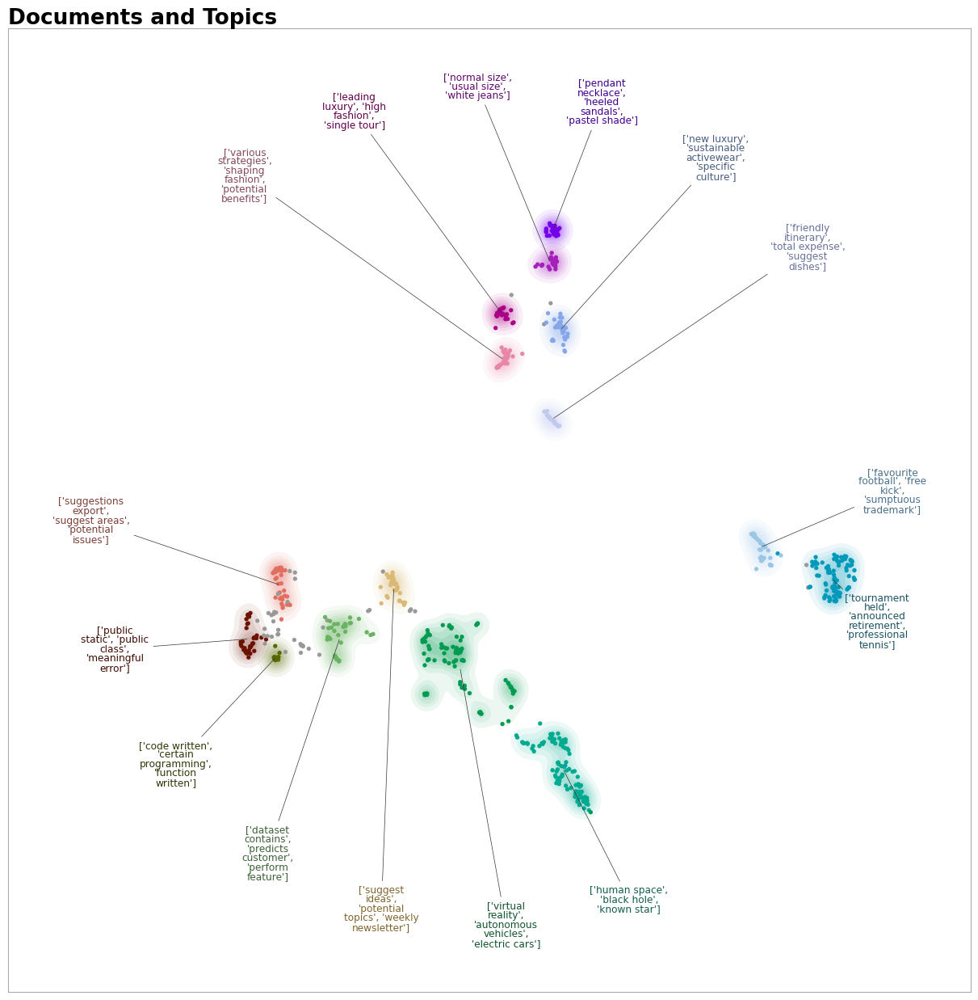

In [82]:
## Visualize the results

POS_TAG = "POS_VERB_NOUN"
custom_labels = True
topic_model.set_topic_labels(topic_model.get_topic_info()[POS_TAG].apply(lambda x: str(x[:3])).tolist()) # Only take the first 3 letters of the POS tag

topic_model.get_topic_info()

fig = topic_model.visualize_documents(prompt_classification_df["Sentence"].tolist(),reduced_embeddings= reduced_embeddings, hide_annotations=True, custom_labels=custom_labels)
fig.write_html(f"figures/prompt_classification_documents_{POS_TAG if custom_labels else 'default'}.html")
fig

fig = topic_model.visualize_document_datamap(prompt_classification_df["Sentence"].tolist(), reduced_embeddings=reduced_embeddings, custom_labels=custom_labels)
fig.savefig(f"figures/prompt_classification_document_datamap_{POS_TAG if custom_labels else 'default'}.png", bbox_inches="tight")


## No robots


In [83]:
# noRobots

hdbscan_model_noRobots = HDBSCAN(min_cluster_size=10,min_samples=5 ,cluster_selection_method="eom", prediction_data=True)

topic_model_noRobots = BERTopic(representation_model=representation_model, vectorizer_model=vectorizer_model,ctfidf_model=ctfidf_model, embedding_model=sentence_model, 
                                                    umap_model = umap_model, hdbscan_model = hdbscan_model_noRobots, calculate_probabilities=False, verbose=True, nr_topics='auto')

topics,  probs = topic_model_noRobots.fit_transform(noRobots_df["prompt"].tolist(), embeddings=np.array(noRobots_df["embedding"].tolist()))

reduced_embeddings_noRobots = UMAP(n_neighbors=10, n_components=2,
                            min_dist=0.0, metric='cosine').fit_transform(np.array(noRobots_df["embedding"].tolist()))



2024-11-08 15:10:03,586 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2024-11-08 15:10:15,651 - BERTopic - Dimensionality - Completed ✓
2024-11-08 15:10:15,661 - BERTopic - Cluster - Start clustering the reduced embeddings
2024-11-08 15:10:15,900 - BERTopic - Cluster - Completed ✓
2024-11-08 15:10:15,916 - BERTopic - Bag of Words - Updating Bag of Words for each topic
2024-11-08 15:10:15,916 - BERTopic - Bag of Words - Tokenization using vectorizer
2024-11-08 15:10:17,250 - BERTopic - Bag of Words - Calculating c-TF-IDF matrix
2024-11-08 15:10:17,383 - BERTopic - Representation - Extracting top words from c_tf_idf
2024-11-08 15:10:17,435 - BERTopic - Representation - Completed ✓
2024-11-08 15:10:17,435 - BERTopic - Topic reduction - Reducing number of topics
2024-11-08 15:10:17,465 - BERTopic - Topic reduction - Auto-reduced number of topics from 172 to 41
2024-11-08 15:10:17,486 - BERTopic - Bag of Words - Updating Bag of Words for each topic
2024-11-08 

,Topic,Count,Name,CustomName,Representation,POS_VERB,POS_NOUN,POS_VERB_NOUN,mmr_model,Representative_Docs
0,-1,3295,-1_food_including_best_water,"['story', 'words', 'poem']","[food, including, best, water, character, dog,...","[write, make, use, list, like, include, need, ...","[story, words, poem, use, time, list, years, p...","[short story, numbered list, social media, sho...","[story, poem, gov, write short, list, like, ch...",[Sift through this blog post and create a list...
1,0,3952,0_character_short story_book_movie,"['story', 'list', 'ideas']","[character, short story, book, movie, food, li...","[want, make, like, list, write, need, include,...","[story, list, ideas, email, poem, love, words,...","[short story, numbered list, main character, b...","[story, like, list, ideas, email, poem, create...","[Here is a review of ""The Old man and the sea""..."
2,1,825,1_pig latin_pig_talks like_frank chatbot,"['chatbot', 'bot', 'questions']","[pig latin, pig, talks like, frank chatbot, ch...","[answers, responds, helps, gives, provides, an...","[chatbot, bot, questions, answers, user, respo...","[answers questions, chatbot responds, answer q...","[questions, chatbot answers, responds, bot hel...",[Can you sum up what these former survivor pla...
3,2,322,2_python code_sudoku_write python_pygame,"['python', 'function', 'grid']","[python code, sudoku, write python, pygame, py...","[return, yellow, print, def, purple, import, n...","[python, function, grid, return, print, code, ...","[return grid, variable called, function doing,...","[15 17, python, function, grid, print, yellow ...","[Hi, I've got a game that my friend sent me. I..."
4,3,162,3_world series_tkachuk_nhl_maple leafs,"['game', 'league', 'basketball']","[world series, tkachuk, nhl, maple leafs, cubs...","[scoring, score, scored, hit, won, lead, playe...","[game, league, basketball, bowl, games, season...","[super bowl, regular season, general manager, ...","[super bowl, brady, season, cubs, super, chess...",[Rewrite this article in the form of several t...
5,4,73,4_physiology_bloodstream_sodium glucose_electr...,"['blood', 'bilirubin', 'absorption']","[physiology, bloodstream, sodium glucose, elec...","[causes, digest, inserted, control, underlies,...","[blood, bilirubin, absorption, body, liver, gl...","[human body, funny current, high blood, little...","[human body, absorption, blood pressure, blood...",[summarize this for a 3 year old:\n\nThe pacem...
6,5,59,5_invented electric_thomas edison_light invent...,"['bulb', 'electric', 'patent']","[invented electric, thomas edison, light inven...","[invented, networking, experimented, created, ...","[bulb, electric, patent, light, rust, platinum...","[light bulb, light bulbs, electric light, seei...","[tesla, coca, westinghouse, platinum, invented...","[In 1802, Humphry Davy invented the first elec..."
7,6,57,6_grand jury_special counsel_impeachment_distr...,"['abortion', 'office', 'attorney']","[grand jury, special counsel, impeachment, dis...","[ban, said, vote, report, convicted, signed, v...","[abortion, office, attorney, state, investigat...","[special counsel, grand jury, obstructing just...","[abortion, holmes, paxton, attorney general, d...","[Review the provided text, an excerpt from a r..."
8,7,52,7_climbing accidents_mount everest_summit moun...,"['climbers', 'summit', 'pyramid']","[climbing accidents, mount everest, summit mou...","[summit, built, climbing, climb, rescue, locat...","[climbers, summit, pyramid, mountain, climber,...","[tallest building, nuclear plant, descending c...","[climbers, hood, summit, mount everest, talles...",[Rewrite this like a mountain enthusiast is ex...
9,8,51,8_climate change_global warming_warming_emissions,"['climate', 'carbon', 'chemicals']","[climate change, global warming, warming, emis...","[climate, warming, change, burned, exposed, pr...","[climate, carbon, chemicals, energy, gas, weat...","[climate change, fossil fuels, global warming,...","[climate change, tobacco, vers

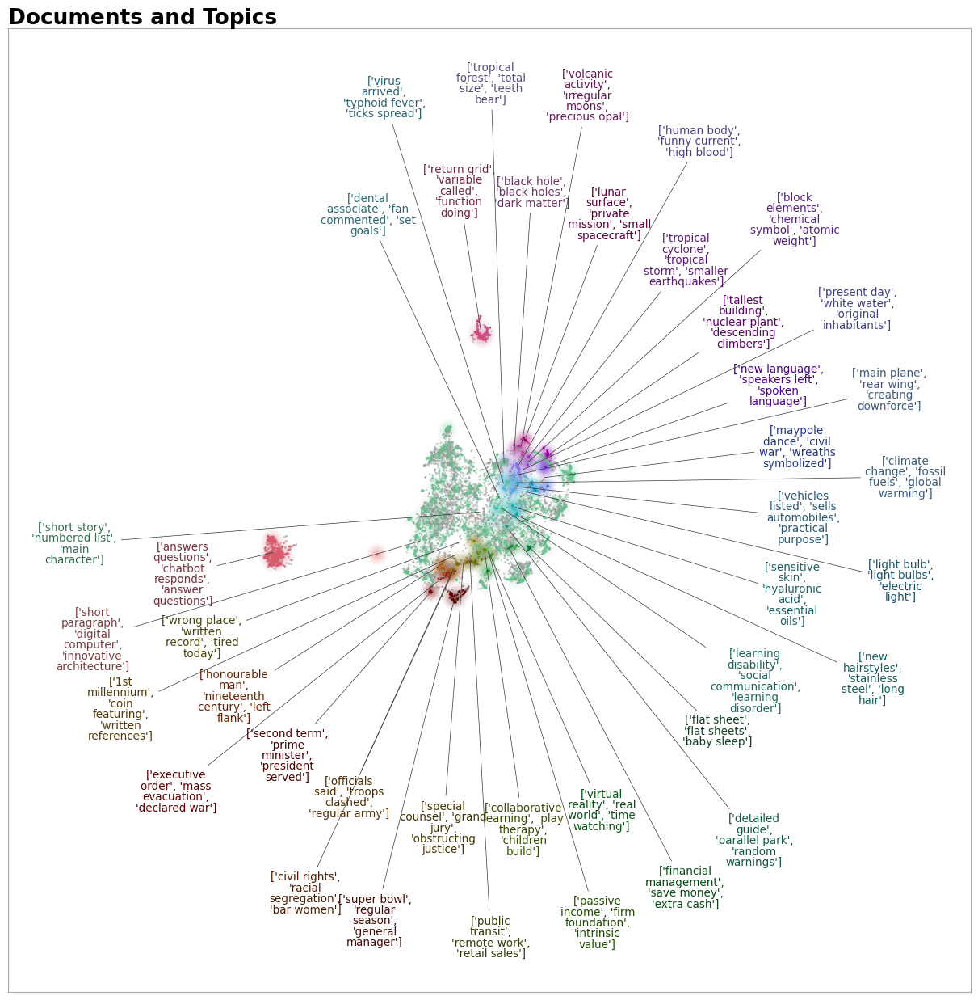

In [86]:
## noRobots
import datamapplot


custom_labels = True
POS_TAG = "POS_VERB_NOUN"
topic_model_noRobots.set_topic_labels(topic_model_noRobots.get_topic_info()[POS_TAG].apply(lambda x: str(x[:3])).tolist()) # Only take the first 3 letters of the POS tag

topic_model_noRobots.get_topic_info()

fig = topic_model_noRobots.visualize_documents(noRobots_df["prompt"].tolist(),reduced_embeddings= reduced_embeddings_noRobots, hide_annotations=True, custom_labels=custom_labels)
fig.write_html(f"figures/documents_noRobots_{POS_TAG if custom_labels else 'default'}.html")
fig

fig = topic_model_noRobots.visualize_document_datamap(noRobots_df["prompt"].tolist(), reduced_embeddings=reduced_embeddings_noRobots, custom_labels=custom_labels)
fig.savefig(f"figures/document_datamap_noRobots_{POS_TAG if custom_labels else 'default'}.png", bbox_inches="tight")



In [88]:
noRobots_df_filtered = noRobots_df[(np.array(topic_model_noRobots.topics_) != 2) & (np.array(topic_model_noRobots.topics_) != 1)] # Lets remove the two big topics related to coding prompts and chatbot prompts

noRobots_df_filtered.shape


(8353, 5)

In [89]:
## Filtered noRobots model

hdbscan_model_noRobots_filtered = HDBSCAN(min_cluster_size=50 ,cluster_selection_method="eom", prediction_data=True)

topic_model_noRobots_filtered = BERTopic(representation_model=representation_model, vectorizer_model=vectorizer_model,ctfidf_model=ctfidf_model, embedding_model=sentence_model, 
                                                    umap_model = umap_model, hdbscan_model = hdbscan_model_noRobots_filtered, calculate_probabilities=False, verbose=True)

topics,  probs = topic_model_noRobots_filtered.fit_transform(noRobots_df_filtered["prompt"].tolist(), embeddings=np.array(noRobots_df_filtered["embedding"].tolist()))

reduced_embeddings_noRobots_filtered = UMAP(n_neighbors=10, n_components=2,
                            min_dist=0.0, metric='cosine').fit_transform(np.array(noRobots_df_filtered["embedding"].tolist()))

print(f'Number of topics: {topic_model_noRobots_filtered.get_topic_info().shape[0]}')


2024-11-08 15:22:49,744 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2024-11-08 15:23:01,085 - BERTopic - Dimensionality - Completed ✓
2024-11-08 15:23:01,090 - BERTopic - Cluster - Start clustering the reduced embeddings
2024-11-08 15:23:01,393 - BERTopic - Cluster - Completed ✓
2024-11-08 15:23:01,425 - BERTopic - Bag of Words - Updating Bag of Words for each topic
2024-11-08 15:23:01,425 - BERTopic - Bag of Words - Tokenization using vectorizer
2024-11-08 15:23:03,074 - BERTopic - Bag of Words - Calculating c-TF-IDF matrix
2024-11-08 15:23:03,157 - BERTopic - Representation - Fine-tuning topics using main representation model
2024-11-08 15:23:07,919 - BERTopic - Representation - Extracting additional topic aspects
2024-11-08 15:23:30,989 - BERTopic - Representation - Completed ✓


Number of topics: 23


,Topic,Count,Name,CustomName,Representation,POS_VERB,POS_NOUN,POS_VERB_NOUN,mmr_model,Representative_Docs
0,-1,3592,-1_skin_research_health_article,"['civil rights', 'hard time', 'following quest...","[skin, research, health, article, summarize, b...","[write, make, said, use, help, want, include, ...","[people, time, article, words, list, world, li...","[civil rights, hard time, following questions,...","[people, write, make, like, list, life, year, ...",[Make this story sound dramatic\n\nValediction...
1,0,1476,0_fairy_novel_fantasy_fiction,"['short story', 'main character', 'little girl']","[fairy, novel, fantasy, fiction, story paragra...","[write, named, make, like, include, want, come...","[story, cat, character, words, movie, film, do...","[short story, main character, little girl, you...","[short story, cat, write story, named, charact...",[Extract the non-playable characters in Mario ...
2,1,443,1_rhyming poem_line poem_poem_poem lines,"['free verse', 'short poem', 'acrostic poem']","[rhyming poem, line poem, poem, poem lines, sh...","[rhyme, rhyming, write, love, create, rhymes, ...","[poem, rhyme, verse, song, lines, stanzas, sch...","[free verse, short poem, acrostic poem, rhymin...","[write poem, lines, free verse, acrostic, chor...",[Extract every year mentioned in this text and...
3,2,416,2_short email_customer service_write email_tex...,"['professional email', 'need help', 'timely ma...","[short email, customer service, write email, t...","[email, sign, ask, send, write, asking, tell, ...","[email, letter, boss, customer, message, job, ...","[professional email, need help, timely manner,...","[write email, letter, let, sign email, casual,...",[Give me the plan name and contact information...
4,3,298,3_chocolate chip_chocolate_recipe_flavors,"['baking soda', 'brown sugar', 'baking powder']","[chocolate chip, chocolate, recipe, flavors, c...","[baking, ricotta, list, make, bake, eat, step,...","[ingredients, chocolate, recipe, cream, cheese...","[baking soda, brown sugar, baking powder, heav...","[recipe, ice cream, grams, flour, calories, ri...",[What is the maximum amount of time I could st...
5,4,272,4_developer_clients_tasks_projects,"['social media', 'write tweets', 'small busine...","[developer, clients, tasks, projects, write tw...","[include, write, click, work, use, need, help,...","[tweet, tweets, business, hashtags, marketing,...","[social media, write tweets, small business, d...","[write tweet, hashtags, seo, blog, launchpass,...",[rewrite this LinkedIn job posting as a blogpo...
6,5,209,5_attractions_places visit_planning trip_natio...,"['national park', 'historic sites', 'live music']","[attractions, places visit, planning trip, nat...","[visit, want, hiking, visiting, like, going, f...","[places, park, museums, parks, trip, beaches, ...","[national park, historic sites, live music, na...","[museums, beaches, places visit, hiking, activ...",[Construct a 3-Day Thailand Itinerary Trip Bas...
7,6,174,6_world series_tkachuk_nhl_maple leafs,"['super bowl', 'regular season', 'general mana...","[world series, tkachuk, nhl, maple leafs, cubs...","[score, scoring, hit, scored, won, lead, playe...","[game, league, basketball, bowl, games, season...","[super bowl, regular season, general manager, ...","[nba, super bowl, brady, super, chess, inning,...",[Rewrite this article in the form of several t...
8,7,164,7_haiku poem_haiku write_poem haiku_write haiku,"['haiku format', 'grammatical errors', 'haiku ...","[haiku poem, haiku write, poem haiku, write ha...","[haikus, write, create, ignore, doubles, faili...","[haiku, haikus, puppies, title, series, errors...","[haiku format, grammatical errors, haiku chain...","[write haiku, write series, series haikus, pup...",[Rewrite the text as a haiku.\n\nMagritte pain...
9,8,160,8_oregon_northwest_mountains_klamath falls,"['hieroglyphic writing', 'tallest building', '...","[oregon, northwest, mountains, klamath falls, ...","[built, located, falls, known, abandoned, occ

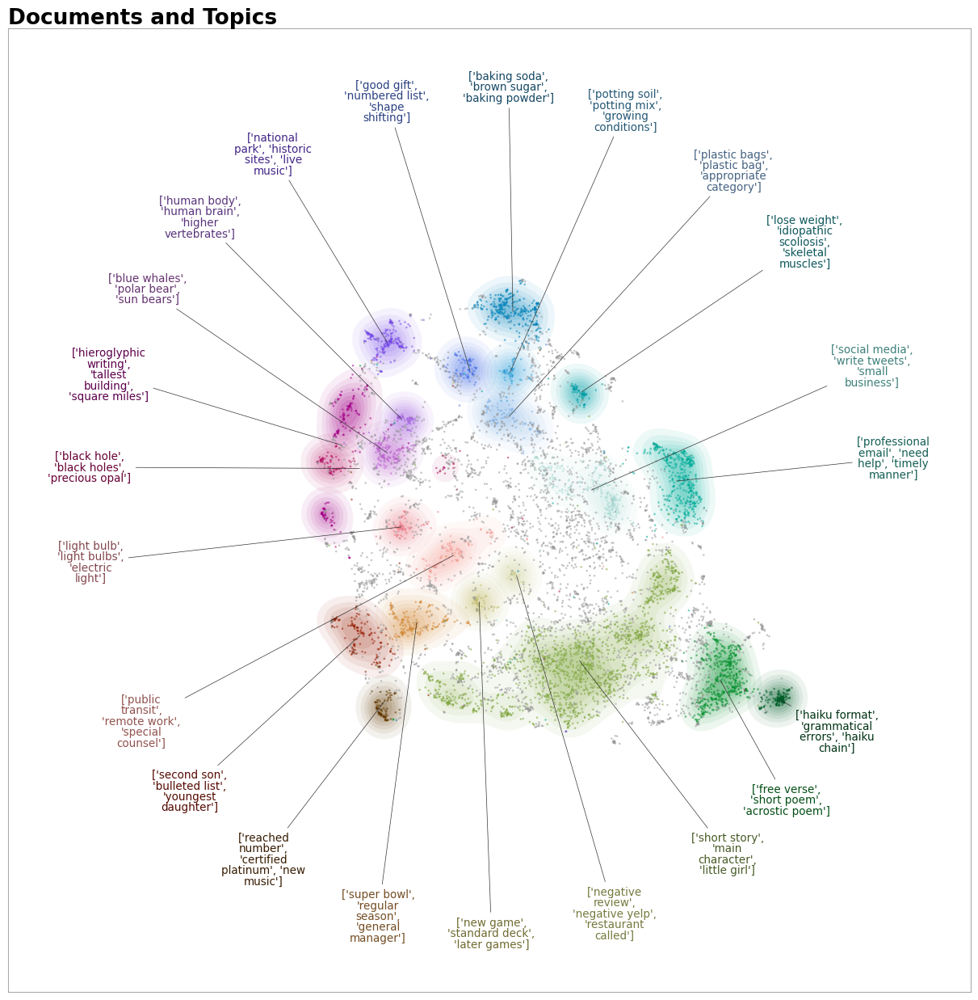

In [97]:
## Visualize the results
custom_labels = True
POS_TAG = "POS_VERB_NOUN"
topic_model_noRobots_filtered.set_topic_labels(topic_model_noRobots_filtered.get_topic_info()[POS_TAG].apply(lambda x: str(x[:3])).tolist()) # Only take the first 3 letters of the POS tag

topic_model_noRobots_filtered.get_topic_info()

fig = topic_model_noRobots_filtered.visualize_documents(noRobots_df_filtered["prompt"].tolist(),reduced_embeddings= reduced_embeddings_noRobots_filtered, hide_annotations=True, custom_labels=custom_labels)
fig.write_html(f"figures/documents_noRobots_filtered_{POS_TAG if custom_labels else 'default'}.html")
fig

fig = topic_model_noRobots_filtered.visualize_document_datamap(noRobots_df_filtered["prompt"].tolist(), reduced_embeddings=reduced_embeddings_noRobots_filtered, custom_labels=custom_labels)
fig.savefig(f"figures/document_datamap_noRobots_filtered_{POS_TAG if custom_labels else 'default'}.png", bbox_inches="tight")



In [ ]:
hierarchical_topics_robots = topic_model_noRobots_filtered.hierarchical_topics(noRobots_df_filtered["prompt"].tolist())


In [102]:

fig = topic_model_noRobots_filtered.visualize_hierarchy(hierarchical_topics=hierarchical_topics_robots, custom_labels=custom_labels)
fig.write_html(f"figures/hierarchical_topics_noRobots_filtered_{POS_TAG if custom_labels else 'default'}.html")
fig

fig = topic_model_noRobots_filtered.visualize_hierarchical_documents(noRobots_df_filtered["prompt"].tolist(), hierarchical_topics_robots,
                                                                      embeddings=np.array(noRobots_df_filtered["embedding"].tolist()),
                                                                      reduced_embeddings=reduced_embeddings_noRobots_filtered,
                                                                      custom_labels=custom_labels,
                                                                      hide_document_hover=False,
                                                                      hide_annotations=True)
fig.write_html(f"figures/hierarchical_documents_noRobots_filtered_{POS_TAG if custom_labels else 'default'}.html")
fig
